In [0]:
# mount the google drive to your Colab session
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
# import required packages
import glob
import os
import numpy as np
import matplotlib.pyplot as plt
import pickle
plt.style.use('fivethirtyeight')

#import packages for image
from IPython.display import Image
from PIL import Image as PIL_Image
import umap
import cv2
from itertools import cycle

#import machine learning packages
from sklearn.cluster import AffinityPropagation
from sklearn import metrics


In [0]:
! ls 'drive/My Drive/capstone image/image_1/'

In [0]:
#load images
image_paths = glob.glob('drive/My Drive/capstone image/image_1/*.jpg')
image_paths.extend(glob.glob('drive/My Drive/capstone image/image_1/*.png'))

print(len(image_paths))

11724


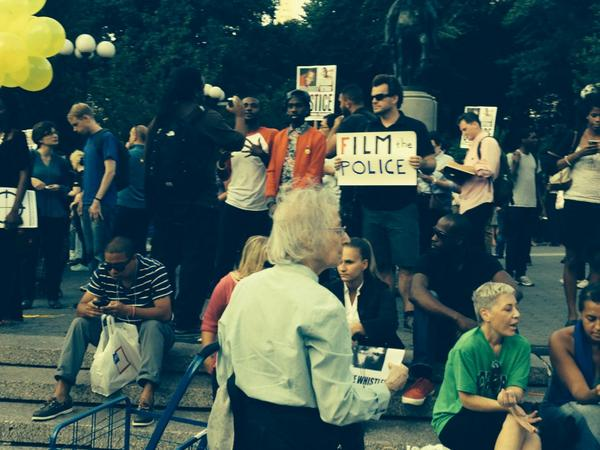

In [0]:
 #visualization
Image(filename=image_paths[2], embed=True, width=500, height=None, retina=False)

In [0]:
! ls 'drive/My Drive/capstone image/embedding'

In [0]:
# perform image embedding using InceptionV3
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input, decode_predictions
from keras.preprocessing import image
model = InceptionV3(include_top=False, pooling='avg')

Using TensorFlow backend.















87916544/87910968 [==============================] - 3s 0us/step


In [0]:
#define required function to process image
def images_to_sprite(data):
    """
    Creates the sprite image along with any necessary padding
    Source : https://github.com/tensorflow/tensorflow/issues/6322
    Args:
      data: NxHxW[x3] tensor containing the images.
    Returns:
      data: Properly shaped HxWx3 image with any necessary padding.
    """
    if len(data.shape) == 3:
        data = np.tile(data[...,np.newaxis], (1,1,1,3))
    data = data.astype(np.float32)
    min = np.min(data.reshape((data.shape[0], -1)), axis=1)
    data = (data.transpose(1,2,3,0) - min).transpose(3,0,1,2)
    max = np.max(data.reshape((data.shape[0], -1)), axis=1)
    data = (data.transpose(1,2,3,0) / max).transpose(3,0,1,2)
    
    n = int(np.ceil(np.sqrt(data.shape[0])))
    padding = ((0, n ** 2 - data.shape[0]), (0, 0),
            (0, 0)) + ((0, 0),) * (data.ndim - 3)
    data = np.pad(data, padding, mode='constant',
            constant_values=0)
    # Tile the individual thumbnails into an image.
    data = data.reshape((n, n) + data.shape[1:]).transpose((0, 2, 1, 3)
            + tuple(range(4, data.ndim + 1)))
    data = data.reshape((n * data.shape[1], n * data.shape[3]) + data.shape[4:])
    data = (data * 255).astype(np.uint8)
    return data


def populate_img_arr(image_paths, size=(100,100),should_preprocess= False):
    """
    Get an array of images for a list of image paths
    Args:
        size: the size of image , in pixels 
        should_preprocess: if the images should be processed (according to InceptionV3 requirements)
    Returns:
        arr: An array of the loaded images
    """
    arr = []
    for i,img_path in enumerate(image_paths):
        try:
            img = image.load_img(img_path, target_size=size)
            x = image.img_to_array(img)
#             print(x)
            arr.append(x)
        except:
            print('Failed Processing: ', img_path)
            
    arr = np.array(arr)
    if should_preprocess:
        arr = preprocess_input(arr)
    return arr  

In [0]:
#create embedding file or load existed embedding files

'''please revise this session to the proper location'''

root_dir = "drive/My Drive/capstone image/embedding"
# for i in range(math.floor(len(image_paths)/1000)): 

directory = root_dir + '/'+ 'tensor_test_2.pickle'

#create the tenero.bytes file using inceptionV3
img_arr = populate_img_arr(image_paths[0:1000], size=(299, 299), should_preprocess=True)
preds = model.predict(img_arr, batch_size=64)
# preds.tofile(directory)
# preds.save(directory)
with open(directory, 'wb') as output_file:
    pickle.dump(preds, output_file)
print('The predict array is created as tensor.bytes')

The predict array is created as tensor.bytes


In [0]:
#read the pickle file
with open("drive/My Drive/capstone image/embedding/tensor0.pickle", 'rb') as f:
    preds = pickle.load(f)


In [0]:
#create embeddeded array as training data
image_vectors = dict(zip(image_paths[0:1000], preds))
X = np.stack(image_vectors.values())
print(X.shape)

(1000, 2048)


/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2822: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  if self.run_code(code, result):


In [0]:
#read all images 
images = []
for image_path in image_paths[0:1000]:
  image = cv2.imread(image_path, 3)

  b,g,r = cv2.split(image)           # get b, g, r
  image = cv2.merge([r,g,b])         # switch it to r, g, b
  image = cv2.resize(image, (700,700)) #feel free to change here for different image visualization pixel
  images.append(image)

images_array = np.array(images)
images_array.shape

(1000, 700, 700, 3)

In [0]:
#convert to lower dimension
reducer = umap.UMAP(n_neighbors=20, random_state=42) # the default n_neighbors is 15 for the software
reducer.fit(X)
embedding = reducer.transform(X)
embedding.shape

(1000, 2)

Text(0.5, 1.0, 'image_dim_reduction')

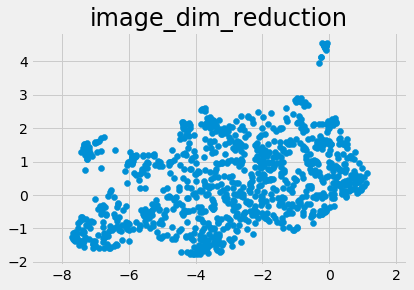

In [0]:
# Visualize dimensionality reduction output.
plt.scatter(embedding[:, 0], embedding[:, 1])
plt.gca().set_aspect('equal', 'datalim')
plt.title('image_dim_reduction', fontsize=24)

In [0]:
#apply affinity propagation
af = AffinityPropagation(affinity='euclidean', 
                         convergence_iter=100, 
                         copy=True,
                         damping=0.9, 
                         max_iter=35000, 
                         preference=None, 
                         verbose=True).fit(embedding)

cluster_centers_indices = af.cluster_centers_indices_
cluster_centers = af.cluster_centers_
affinity_matrix = af.affinity_matrix_
n_iter = af.n_iter_
labels = af.labels_

n_clusters_ = len(cluster_centers_indices)

print('Estimated number of clusters: %d' % n_clusters_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(X, labels, metric='sqeuclidean'))

Converged after 186 iterations.
Estimated number of clusters: 24
Silhouette Coefficient: 0.052


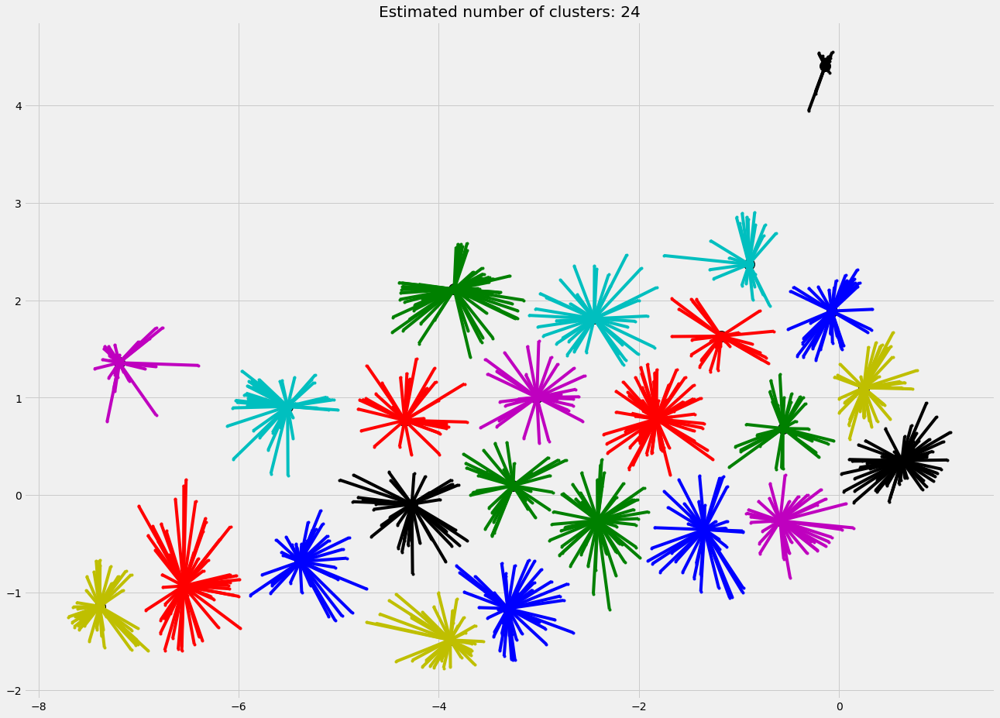

In [0]:
# Plot result

plt.close('all')
plt.figure(figsize=(20,15))
plt.clf()

colors = cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
for k, col in zip(range(n_clusters_), colors):
    class_members = labels == k
    cluster_center = embedding[cluster_centers_indices[k]]
    plt.plot(embedding[class_members, 0], embedding[class_members, 1], col + '.')
    plt.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
             markeredgecolor='k', markersize=14)
    for x in embedding[class_members]:
        plt.plot([cluster_center[0], x[0]], [cluster_center[1], x[1]], col)
#         plt.annotate(k, 
#                  dict_label[k],
#                  horizontalalignment='center',
#                  verticalalignment='center',
#                  size=30, weight='bold') 

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

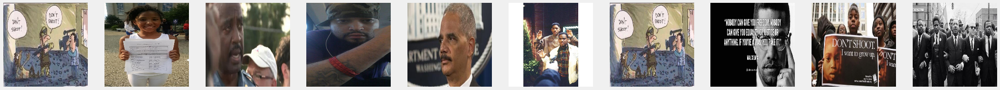

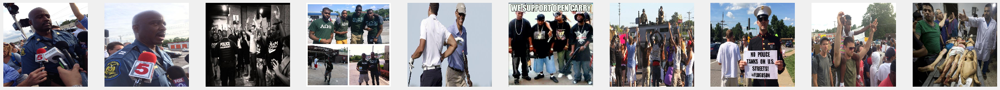

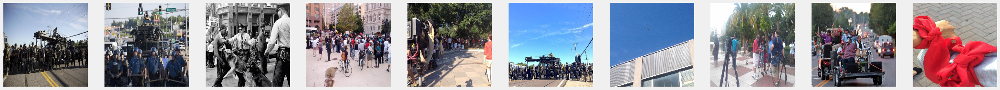

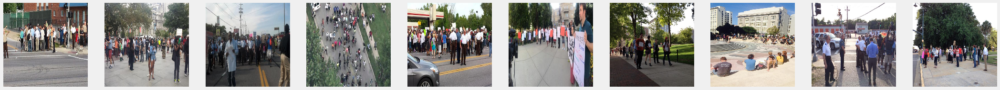

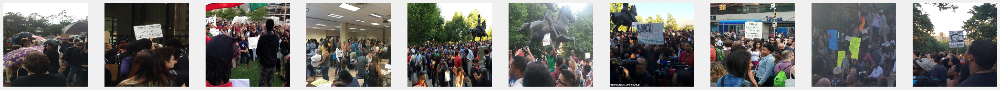

...

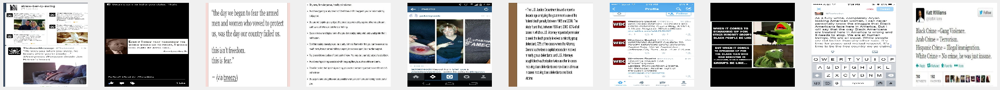

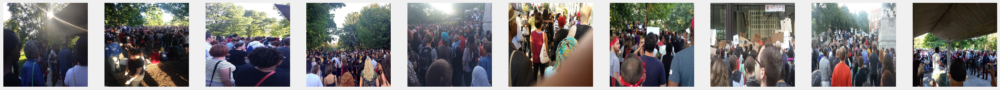

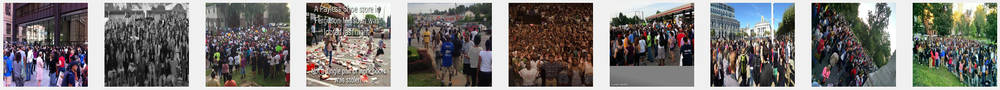

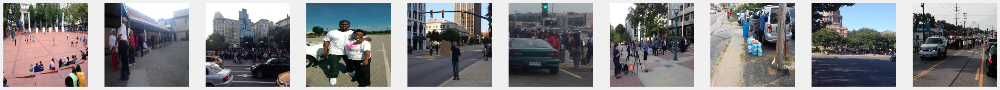

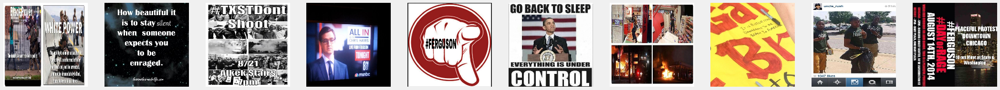

In [0]:
num_clusters =n_clusters_

# plt.figure(figsize=(20,20))

for num_cluster in range(num_clusters):
  plt.close('all')
  fig = plt.figure(figsize = (40,100))
  
  sample_index = np.where(labels == num_cluster)
  image_selected = [images[i] for i in sample_index[0].tolist()]
  if len(image_selected) >10:
    for i in range(10):

  
      fig.add_subplot(num_cluster+1,12,i+1)
      plt.imshow(image_selected[i])
      plt.axis('off')
        
    plt.savefig('drive/My Drive/capstone image/image_cluster_result/umap_ouput_{}.pdf'.format(num_cluster)) 
    plt.show()
  else:
    continue


plt.close('all')